# Imports

In [1]:
import os
os.chdir('/mas/u/asma_gh/disco')

import tensorflow as tf
from tensorboard.backend.event_processing import event_accumulator
from test_explainer_discoverer import test as test_discoverer
from test_csvae import test as test_csvae
from utils import inverse_image, make3d
import yaml
import pandas as pd
import numpy as np
import math
import matplotlib.pyplot as plt
import pdb

import warnings
warnings.filterwarnings("ignore") 

tf.__version__

/usr/lib/python3.5/importlib/_bootstrap.py:222: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/usr/lib/python3.5/importlib/_bootstrap.py:222: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/usr/lib/python3.5/importlib/_bootstrap.py:222: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/usr/lib/python3.5/importlib/_bootstrap.py:222: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/usr/lib/python3.5/importlib/_bootstrap.py:222: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/usr/lib/python3.5/importlib/_bootstrap.py:222: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected

'1.12.3'

In [2]:
# First set
# SHAPES_SAMPLE_INDICES = [238944, 209719, 220278, 205815, 211683, 
#                   245252, 255045, 258990, 259189, 273785, 
#                   310989, 335740, 331129, 294386, 295864, 
#                   311612, 234900, 215548, 163173, 230222, 
#                   9701, 369743, 249791, 475592, 9693, 
#                   14923, 15074, 327300, 38929, 327003]

# second set
# SHAPES_SAMPLE_INDICES = [238944, 209719, 220278, 205815, 211683, 
#                          293252, 303045, 306990, 307189, 321785, 
#                          260109, 331900, 423289, 197426, 293464, 
#                          234900, 215548, 163173, 230222, 220720, 
#                          251141, 275183, 250751, 285032, 251613, 
#                          14443, 14594, 326820, 38449, 326523, 
#                          264263, 283434, 240197, 283313, 269166]

# third set
SHAPES_SAMPLE_INDICES = [238944, 209719, 220278, 205815, 213603, 
                         304789, 304505, 306635, 325146, 290048, 
                         250297, 144778, 159125, 312770, 379710, 
                         119699, 254088, 148544, 66866, 110373, 
                         281282, 253706, 257323, 241785, 241838, 
                         158798, 384075, 115219, 398696, 220886, 
                         278751, 283244, 249793, 278555, 269272]


SHAPES_SAMPLE_INDICES_SUBSET = [220278, 
                                306635,
                                238944,
                                241785,  
                                278751, 
                                249793,]
SHAPES_IMG_LBL_DICT = './output/classifier/shapes-redcyan/explainer_input/list_attr_3_all.txt'

BASELINE_CONFIG = './configs/redcyan_experiments/shapes_redcyan_Explainer.yaml'
BASELINE_PLUS_CONFIG = './configs/redcyan_experiments/shapes_redcyan_Explainer_2_dim.yaml'
OURS_CONFIG = './configs/redcyan_experiments/shapes_redcyan_Discoverer_2_dim_r10.yaml'

CSVAE_SHAPES_CONFIG = './configs/csvae_experiments/shapes_redcyan_csvae_multidim.yaml'
CSVAE_CELEBA_CONFIG = './configs/csvae_experiments/celeba64_biased_or_csvae_multidim.yaml'

# Counterfactual Image Trajectories utils

In [3]:
def save_target_images(img, num_class, image_size=128,num_channel=3):
    img = make3d(img, num_channel=num_channel, image_size=image_size, row=1, col=num_class)                      
    img = inverse_image(img)
    return img

def view(img, num_samples, NUMS_CLASS, generation_dim, real_pred, FAKE_IMG, fake_pred, image_size):
    img = inverse_image(img)
    fake_pred = np.round(fake_pred, decimals=2)
    for i in range(num_samples):
        plt.figure(figsize = (3,3))
        plt.imshow(img[i])
        plt.title(" Output of pre. cls: {:.2f}".format(real_pred[i, 0, 0, 1]))
        plt.show()
        for j in range(generation_dim):
            plt.figure(figsize = (3 * NUMS_CLASS, 3))
            temp = save_target_images(FAKE_IMG[i, j], NUMS_CLASS, 
                                      image_size=image_size)
            plt.title("Knob {} - ".format(j+1)+"Generated image cls output: " + str(
                fake_pred[i, j, :, 1]))
            plt.imshow(temp)
            plt.show()


# Tensorboard utils

In [4]:
def plot_tensorboard_summary(log_file_name):
    plt.figure()
    ea = event_accumulator.EventAccumulator(log_file_name,size_guidance={ 
        event_accumulator.COMPRESSED_HISTOGRAMS: 1,
        event_accumulator.IMAGES: 1,
        event_accumulator.AUDIO: 1,
        event_accumulator.SCALARS: 5000,
        event_accumulator.HISTOGRAMS: 1,
        event_accumulator.TENSORS: 1,
        })
    ea.Reload()
    scalars = sorted(ea.Tags()['scalars'])
    def plot(scalars, n_cols=4, subplot_size=5):
        n_rows = math.ceil(len(scalars)/n_cols)
        plt.figure(figsize=(subplot_size*n_cols, subplot_size*n_rows))
        counter = 1
        for counter, s in enumerate(scalars):
            plt.subplot(n_rows, n_cols, counter+1)
            df = pd.DataFrame(ea.Scalars(s))
            plt.scatter(x=df['step'], y=df['value'])
            plt.title(s)
        plt.show()
    plot(scalars)        

# Overall Utils

In [5]:
def view_images(config_path, num_samples, plot_tensorboard=False, img_indices=[], img_label_dict=None):
    tf.reset_default_graph()
    config = yaml.load(open(config_path))
    if 'w_dim' in config.keys():
        generation_dim = config['w_dim']
        # Run explainer/discoverer and get outputs
        results_dict = test_csvae(config, dbg_mode=True, export_output=False, dbg_size=num_samples, 
                                  dbg_img_indices=img_indices, dbg_img_label_dict=img_label_dict, 
                                  calc_stability=False)
    else:

        generation_dim = config['k_dim']
        # Run explainer/discoverer and get outputs
        results_dict = test_discoverer(config, dbg_mode=True, export_output=False, dbg_size=num_samples, 
                                       dbg_img_indices=img_indices, dbg_img_label_dict=img_label_dict, 
                                       calc_stability=False)

    # plot tensorboard summary
    if plot_tensorboard:
        log_dir = os.path.join(config['log_dir'], config['name'], 'log')
        all_files = sorted(os.listdir(log_dir))
        log_file_name = os.path.join(log_dir, all_files[-2])
        plot_tensorboard_summary(log_file_name)
        
    # plot image trajectories
    view(results_dict['real_imgs'], num_samples, config['num_bins'], generation_dim, results_dict['real_ps'], 
         results_dict['fake_t_imgs'], results_dict['fake_ps'], config['input_size'])

def print_metrics_table(model_configs):
    df = pd.DataFrame()
    for model_name in model_configs.keys():
        config = yaml.load(open(model_configs[model_name]))
        metrics_file = os.path.join(config['log_dir'], config['name'], 'test', 'metrics', 'metrics.csv')
        cur_df = pd.read_csv(metrics_file, index_col=0)
        cur_df['method'] = model_name
        df = pd.concat([cur_df, df]).reset_index(drop=True)
    def _score_to_percent(series):
        for col, _ in series.items():
            if 'accuracy' in col or 'precision' in col or 'recal' in col:
                series[col] *= 100.0
        return series
            
    sorted_cols = ['method', 
                   'influential_pearson_r', 'influential_pearson_p',
                   'influential_spearman_r', 'influential_spearman_p', 
                   'influential_KL',
                   'realistic_accuracy', 'realistic_precision', 'realistic_recall', 
                   'distinct_accuracy', 
                   'distinct_precision_micro', 'distinct_precision_macro', #'distinct_precision_per_dim',
                   'distinct_recall_micro', 'distinct_recall_macro', #'distinct_recall_per_dim'
                   'substitutability_accuracy', 'substitutability_precision', 'substitutability_recall',
                   'generalization_accuracy', 'generalization_precision', 'generalization_recall',
                   'stability_l2_fake_t_img', 'stability_l2_fake_s_recon_img', 'stability_l2_recon_p', 'stability_l2_fake_p',
                  ]
    df = df.reindex(columns=sorted_cols)
    df = df.apply(_score_to_percent, axis=1)
    df = df.round(3)
    print(df)
    return df

In [6]:
%%capture --no-display
def _find_ind(arr, ind):
    for i, val in enumerate(arr):
        if val == str(ind):
            return i
    return None

def plot_qualitative_results(models_results, inds):
    TITLE_SIZE = 20
    n_bins = 3 # todo
    n_dims = 2
    fig_s = 3
    target_class = 1
    cols = len(models_results.keys()) * (n_bins + 1) + 1
    rows = len(inds) * (n_dims + 1)
    plt.figure(figsize=(fig_s * cols, fig_s * rows))
    
    counter = 1
    for ind in inds:
        # plot query image only once            
        plt.subplot(rows, cols, counter)
        baseline_model = models_results['baseline']
        real_img_ind = _find_ind(baseline_model['names'], ind)
        plt.title('Query\n'+r'$f(x)$={:.2f}'.format(baseline_model['real_ps'][real_img_ind, 0, 0, target_class]),
                 fontsize=TITLE_SIZE)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(baseline_model['real_imgs'][real_img_ind])
        counter += 2
        for dim in range(n_dims + 1):
            for mdl, model_name in enumerate(sorted(models_results.keys())):
                single_model = models_results[model_name]
                img_ind = _find_ind(single_model['names'], ind)
                for bin_i in range(n_bins+1):
                    if (dim == n_dims): # empty line between samples
                        counter += 1
                        continue
                    if (bin_i == n_bins): # empty column between models
                        counter += 1
                        continue
                    if model_name == 'baseline':
                        if dim > 0:
                            if bin_i ==0:
                                counter += 1
                            counter += 1
                            continue
                        fake_img_ind = img_ind * n_bins + bin_i
                    else:
                        fake_img_ind = img_ind * n_dims * n_bins + dim * n_bins + bin_i
                    plt.subplot(rows, cols, counter)
                    prefix = '\n'
                    if bin_i == (n_bins)//2 and dim == 0:
                        prefix = model_name + prefix
                    plt.title(prefix+r'$f(x_{\delta})$'+'={:.2f}'.format(single_model['fake_ps'][img_ind, dim, bin_i, target_class]),
                             fontsize=TITLE_SIZE)
                    plt.xticks([])
                    plt.yticks([])
                    plt.imshow(single_model['fake_t_imgs'][img_ind, dim, bin_i])
                    counter += 1
    
    plt.subplots_adjust(wspace=0, hspace=0.2)
    plt.show()

Debug mode activated. #35 samples from the shapes dataset will be considered.
The classification categories are: 
['[0.00', '0.50)', '[0.50', '1.00)']
The size of the test set:  35
encoder_z
Tensor("x_source:0", shape=(?, 64, 64, 3), dtype=float32)
: Tensor("encoder_z/Encoder-ConvBlock3/Relu:0", shape=(?, 32, 32, 64), dtype=float32)
: Tensor("encoder_z/Encoder-ConvBlock2/Relu:0", shape=(?, 16, 16, 128), dtype=float32)
: Tensor("encoder_z/Encoder-ConvBlock1/Relu:0", shape=(?, 8, 8, 256), dtype=float32)
: Tensor("encoder_z/Sum:0", shape=(?, 256), dtype=float32)
: Tensor("encoder_z/Relu:0", shape=(?, 2048), dtype=float32)
: Tensor("encoder_z/Relu_1:0", shape=(?, 4), dtype=float32)
encoder_w
Tensor("x_source:0", shape=(?, 64, 64, 3), dtype=float32)
: Tensor("encoder_w/Encoder-ConvBlock3/Relu:0", shape=(?, 32, 32, 64), dtype=float32)
: Tensor("encoder_w/Encoder-ConvBlock2/Relu:0", shape=(?, 16, 16, 128), dtype=float32)
: Tensor("encoder_w/Encoder-ConvBlock1/Relu:0", shape=(?, 8, 8, 256), dt

35it [00:00, 48577.31it/s]

Classifier checkpoint loaded.................
./output/classifier/shapes-redcyan cp1_epoch4.ckpt


1 / 1


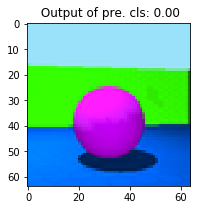

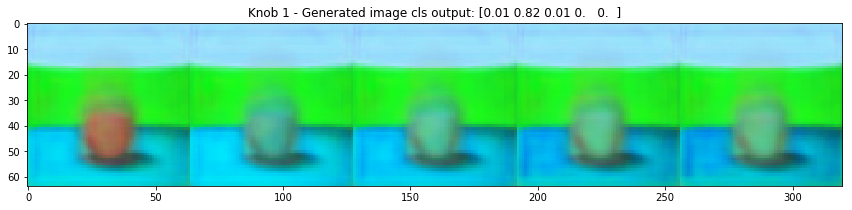

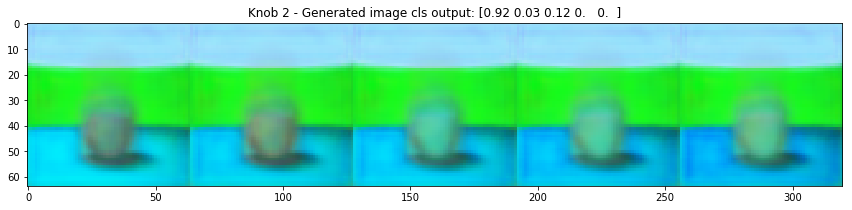

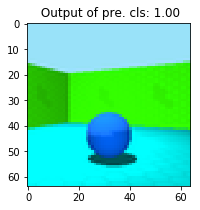

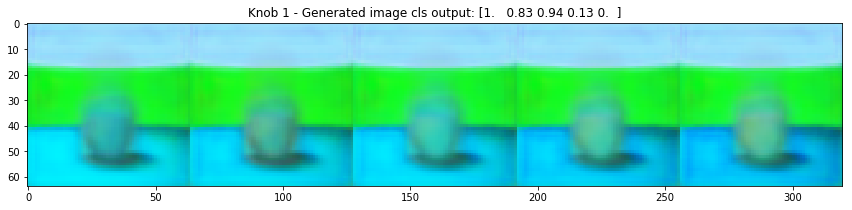

...

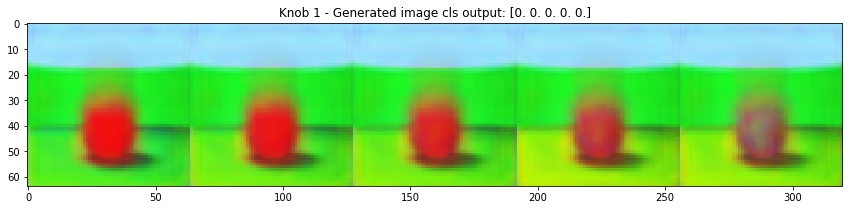

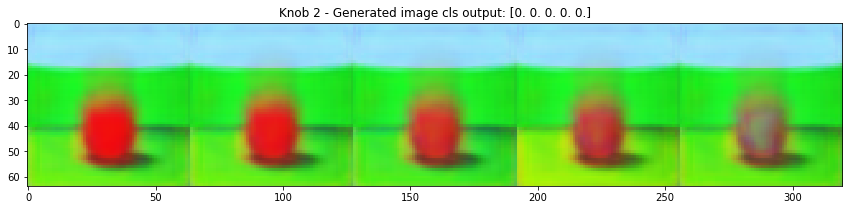

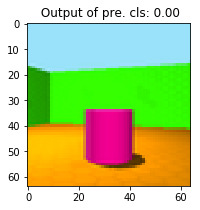

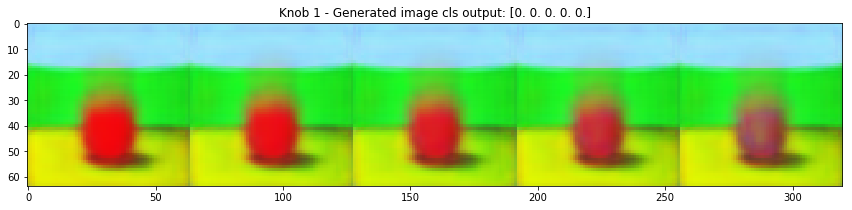

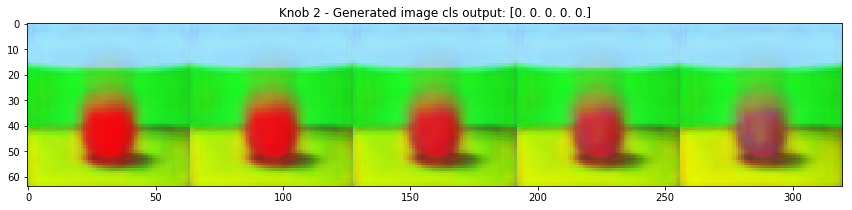

In [7]:
CSVAE_SHAPES_INDICES=[220278, 
                      306635,
                      238944,
                      241785,  
                      278751, 
                      249793,]

CSVAE_SHAPES_INDICES = [238944, 209719, 220278, 205815, 213603, 
                         304789, 304505, 306635, 325146, 290048, 
                         250297, 144778, 159125, 312770, 379710, 
                         119699, 254088, 148544, 66866, 110373, 
                         281282, 253706, 257323, 241785, 241838, 
                         158798, 384075, 115219, 398696, 220886, 
                         278751, 283244, 249793, 278555, 269272]
CSVAE_SHAPES_IMG_LBLB_DICT = './output/classifier/shapes-redcyan/explainer_input/list_attr_2_all.txt'
view_images('./configs/csvae_experiments/shapes_redcyan_csvae_multidim.yaml', 35, 
            img_indices=CSVAE_SHAPES_INDICES, img_label_dict=CSVAE_SHAPES_IMG_LBLB_DICT)


In [8]:
print_metrics_table({'CSVAE shapes': CSVAE_SHAPES_CONFIG,
                     'CSVAE celeba biased or': CSVAE_CELEBA_CONFIG})

                   method  influential_pearson_r  influential_pearson_p  \
0            CSVAE shapes                 -0.066                  0.001   
1  CSVAE celeba biased or                 -0.958                  0.000   

   influential_spearman_r  influential_spearman_p  influential_KL  \
0                  -0.557                     0.0          18.411   
1                  -0.979                     0.0           1.636   

   realistic_accuracy  realistic_precision  realistic_recall  \
0              94.531               95.522            94.118   
1             100.000              100.000           100.000   

   distinct_accuracy         ...           substitutability_accuracy  \
0             39.844         ...                              49.609   
1             16.000         ...                              43.750   

   substitutability_precision  substitutability_recall  \
0                         0.0                      0.0   
1                         0.0           

,method,influential_pearson_r,influential_pearson_p,influential_spearman_r,influential_spearman_p,influential_KL,realistic_accuracy,realistic_precision,realistic_recall,distinct_accuracy,...,substitutability_accuracy,substitutability_precision,substitutability_recall,generalization_accuracy,generalization_precision,generalization_recall,stability_l2_fake_t_img,stability_l2_fake_s_recon_img,stability_l2_recon_p,stability_l2_fake_p
0,CSVAE shapes,-0.066,0.001,-0.557,0.0,18.411,94.531,95.522,94.118,39.844,...,49.609,0.0,0.0,NaN,NaN,NaN,0.642,0.668,0.034,0.003
1,CSVAE celeba biased or,-0.958,0.000,-0.979,0.0,1.636,100.000,100.000,100.000,16.000,...,43.750,0.0,0.0,50.0,0.0,0.0,0.000,0.000,0.008,0.000


The classification categories are: 
['[0.00', '0.50)', '[0.50', '1.00)']
The size of the test set:  20000
encoder_z
Tensor("x_source:0", shape=(?, 64, 64, 3), dtype=float32)
: Tensor("encoder_z/Encoder-ConvBlock3/Relu:0", shape=(?, 32, 32, 64), dtype=float32)
: Tensor("encoder_z/Encoder-ConvBlock2/Relu:0", shape=(?, 16, 16, 128), dtype=float32)
: Tensor("encoder_z/Encoder-ConvBlock1/Relu:0", shape=(?, 8, 8, 256), dtype=float32)
: Tensor("encoder_z/Sum:0", shape=(?, 256), dtype=float32)
: Tensor("encoder_z/Relu:0", shape=(?, 2048), dtype=float32)
: Tensor("encoder_z/Relu_1:0", shape=(?, 4), dtype=float32)
encoder_w
Tensor("x_source:0", shape=(?, 64, 64, 3), dtype=float32)
: Tensor("encoder_w/Encoder-ConvBlock3/Relu:0", shape=(?, 32, 32, 64), dtype=float32)
: Tensor("encoder_w/Encoder-ConvBlock2/Relu:0", shape=(?, 16, 16, 128), dtype=float32)
: Tensor("encoder_w/Encoder-ConvBlock1/Relu:0", shape=(?, 8, 8, 256), dtype=float32)
: Tensor("encoder_w/Sum:0", shape=(?, 256), dtype=float32)
: T

5it [00:00, 26.66it/s]

Classifier checkpoint loaded.................
./output/classifier/CelebA64-biased_or cp1_epoch4.ckpt


1 / 1


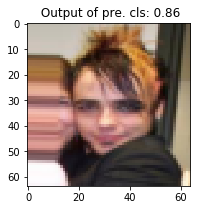

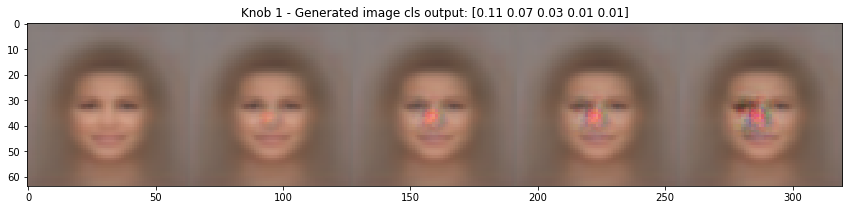

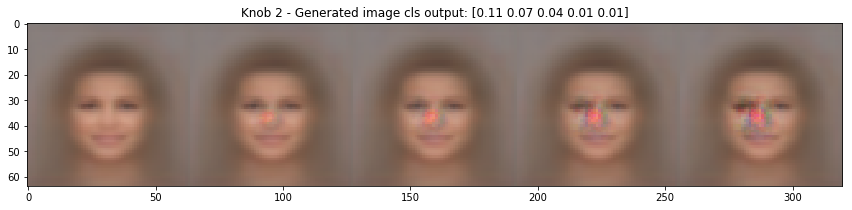

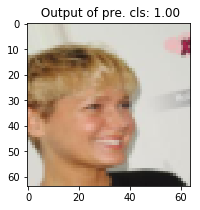

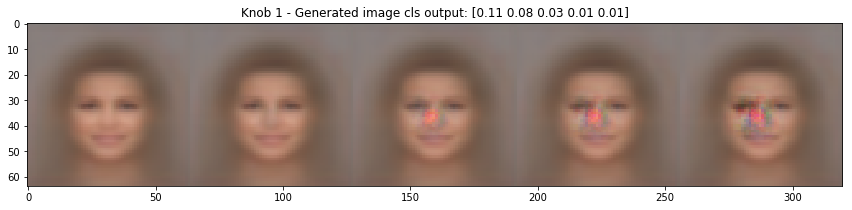

...

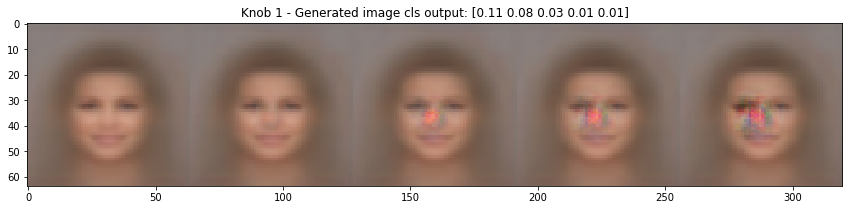

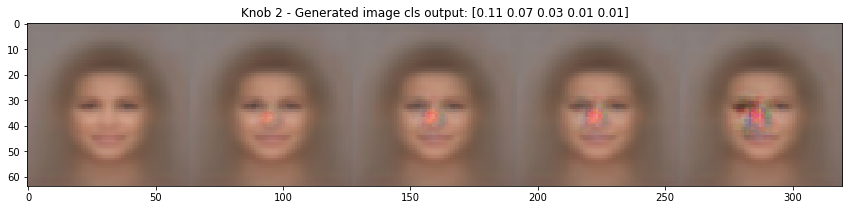

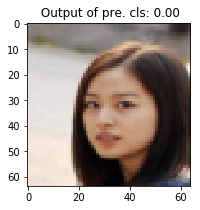

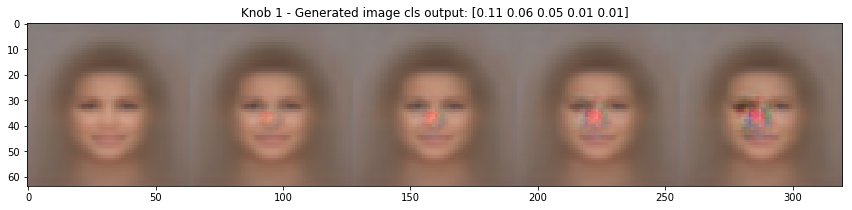

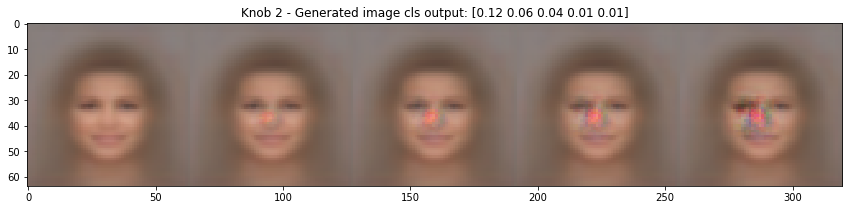

In [9]:
# CSVAE_CELEBA_INDICES=[]
# CSVAE_CELEBA_IMG_LBLB_DICT = './output/classifier/CelebA-biased_or/explainer_input/list_attr_2_all.txt'
view_images('./configs/csvae_experiments/celeba64_biased_or_csvae_multidim.yaml', 5 ) #, 
#            img_indices=CSVAE_SHAPES_INDICES, img_label_dict=CSVAE_SHAPES_IMG_LBLB_DICT)


The classification categories are: 
['[0.00', '0.10)', '[0.10', '0.20)', '[0.20', '0.30)', '[0.30', '0.40)', '[0.40', '0.50)', '[0.50', '0.60)', '[0.60', '0.70)', '[0.70', '0.80)', '[0.80', '0.90)', '[0.90', '1.00)']
The size of the training set:  5
Tensor("x_source:0", shape=(?, 64, 64, 3), dtype=float32)
Tensor("discriminator/add:0", shape=(?, 32, 32, 64), dtype=float32)
Tensor("discriminator/add_1:0", shape=(?, 16, 16, 128), dtype=float32)
Tensor("discriminator/add_2:0", shape=(?, 8, 8, 256), dtype=float32)
Tensor("discriminator/add_3:0", shape=(?, 4, 4, 512), dtype=float32)
Tensor("discriminator/Relu:0", shape=(?, 4, 4, 512), dtype=float32)
Instructions for updating:
keep_dims is deprecated, use keepdims instead
Encoder-Decoder
Tensor("x_source:0", shape=(?, 64, 64, 3), dtype=float32)
: Tensor("generator/BiasAdd:0", shape=(?, 64, 64, 64), dtype=float32)
: Tensor("generator/add:0", shape=(?, 32, 32, 512), dtype=float32)
: Tensor("generator/add_1:0", shape=(?, 16, 16, 1024), dtype=fl

5it [00:00, 55.28it/s]

Classifier checkpoint loaded.................
./output/classifier/dermatology-inflammatory-malignant cp1_epoch9.ckpt


1 / 1


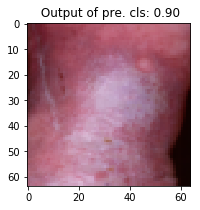

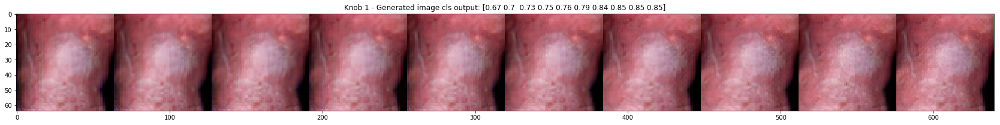

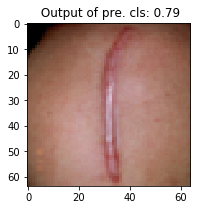

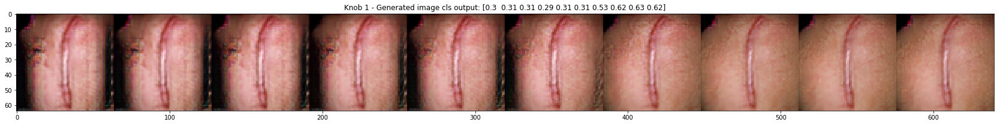

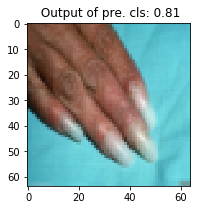

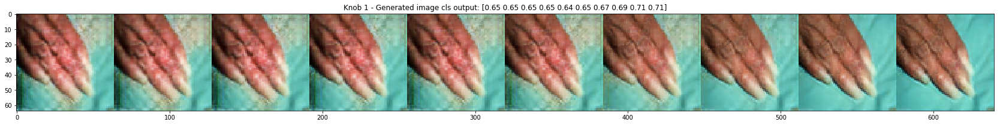

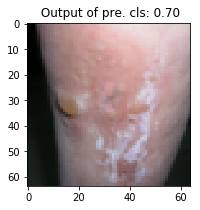

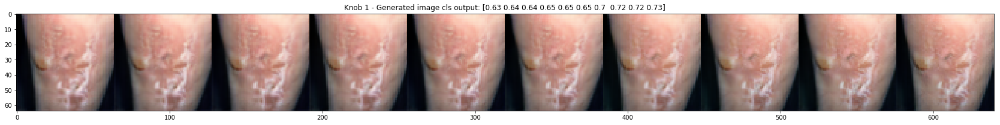

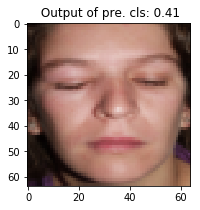

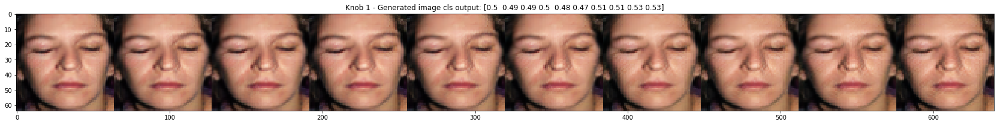

In [10]:
DERMATOLOGY_SAMPLE_INDICES=['httpswwwdermquestcomimagelibrarylarge025732HBJPG.jpg',
                            'httpdermatoweb2udlesimagesfotosgransqueliode13jpg.jpg',
                            'httpdermatoweb2udlesimagesfotosgranslipodermatoesclerosis02jpg.jpg',
                            'httpwwwhellenicdermatlascomphotos0000233300002333standalonejpg.jpg',
                           'httpdermatoweb2udlesimagesfotosgransurticariacomun49jpg.jpg',
                           ]
DERMATOLOGY_IMG_LBLB_DICT = './output/classifier/dermatology-inflammatory-malignant/explainer_input/list_attr_10_5000.txt'
view_images('./configs/dermatology_experiments/dermatology_inflammatory-malignant_Explainer.yaml', 5, 
            img_indices=DERMATOLOGY_SAMPLE_INDICES, img_label_dict=DERMATOLOGY_IMG_LBLB_DICT)

# Does having more discovery dimensions than ground truth dimensions find anything interesting?

INFO:tensorflow:Restoring parameters from ./output/discoverer/redcyan_experiments/shapes_redcyan_Discoverer_10_dim_r50/ckpt_dir/model236000.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcyan/cp1_epoch4.ckpt


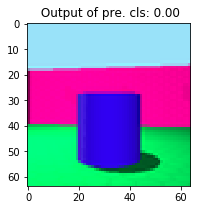

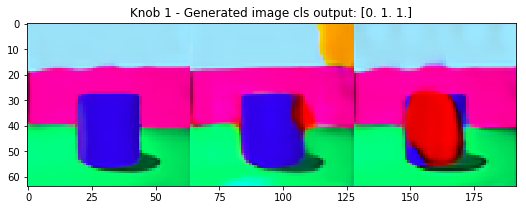

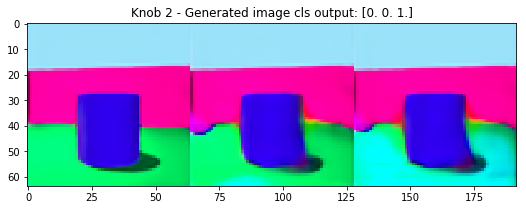

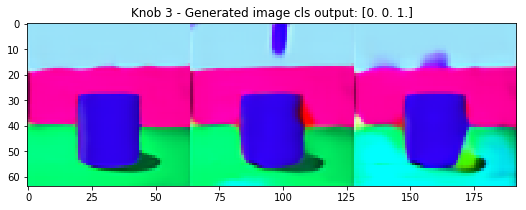

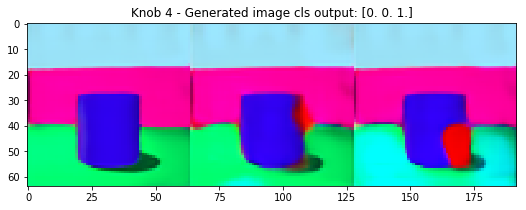

...

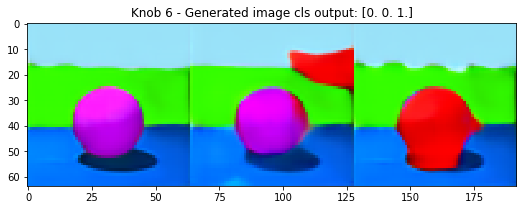

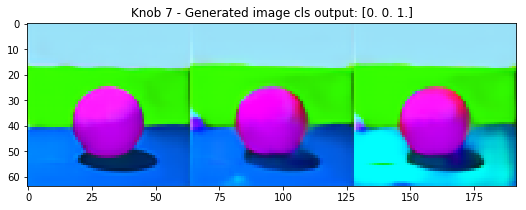

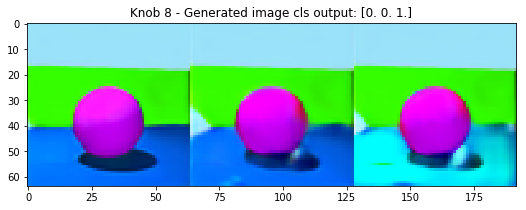

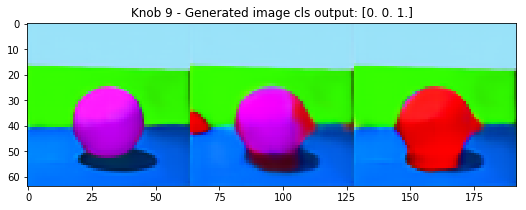

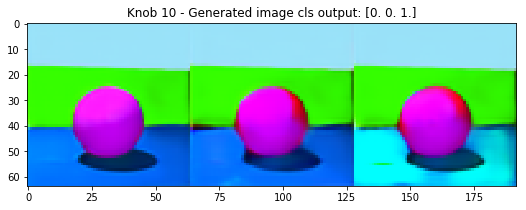

In [11]:
%%capture --no-display
# Baseline with 1 knob
view_images('./configs/redcyan_experiments/shapes_redcyan_Discoverer_10_dim_r50.yaml', 6,
            img_indices=SHAPES_SAMPLE_INDICES_SUBSET, img_label_dict=SHAPES_IMG_LBL_DICT)

INFO:tensorflow:Restoring parameters from ./output/discoverer/redcyan_experiments/shapes_redcyan_Discoverer_10_dim_r10/ckpt_dir/model281500.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcyan/cp1_epoch4.ckpt


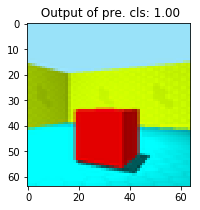

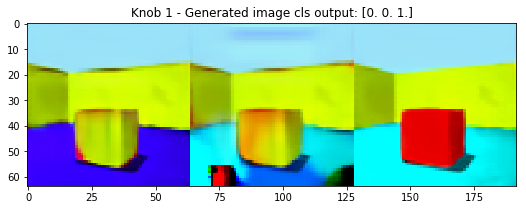

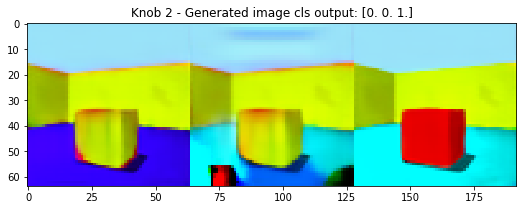

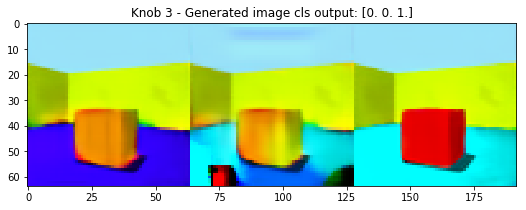

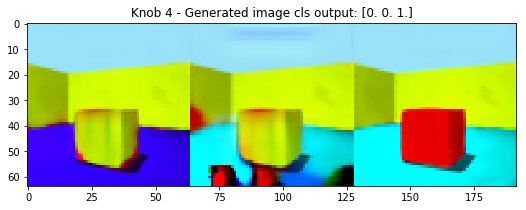

...

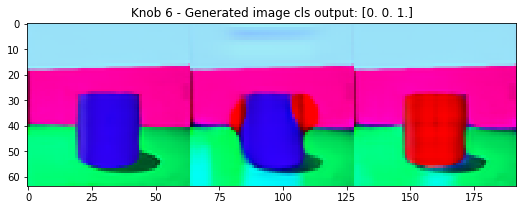

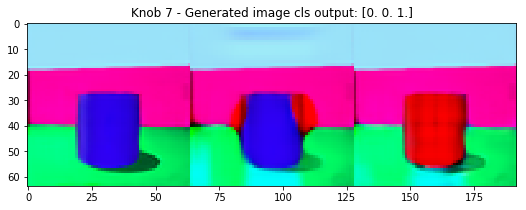

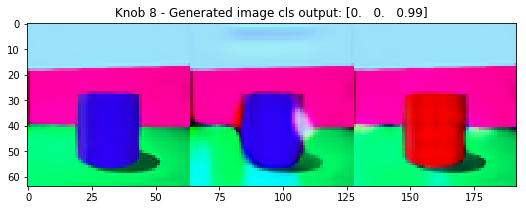

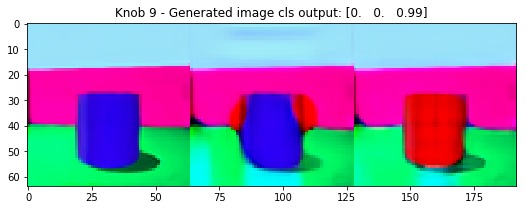

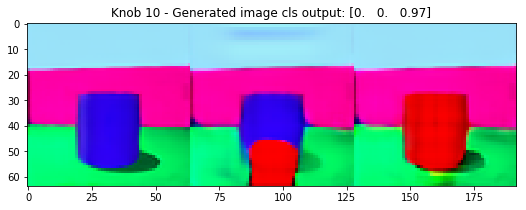

In [12]:
%%capture --no-display
# Baseline with 1 knob
view_images('./configs/redcyan_experiments/shapes_redcyan_Discoverer_10_dim_r10.yaml', 6,
            img_indices=SHAPES_SAMPLE_INDICES_SUBSET, img_label_dict=SHAPES_IMG_LBL_DICT)

# Main qualitative

In [13]:
%%capture --no-display
tf.reset_default_graph()
baseline_results = test_discoverer(yaml.load(open(BASELINE_CONFIG)), dbg_mode=True, 
                        export_output=False, dbg_size=35,  dbg_img_indices=SHAPES_SAMPLE_INDICES, 
                        dbg_img_label_dict=SHAPES_IMG_LBL_DICT, calc_stability=False)
tf.reset_default_graph()
baseline_plus_results = test_discoverer(yaml.load(open(BASELINE_PLUS_CONFIG)), dbg_mode=True, 
                        export_output=False, dbg_size=35,  dbg_img_indices=SHAPES_SAMPLE_INDICES, 
                        dbg_img_label_dict=SHAPES_IMG_LBL_DICT, calc_stability=False)

tf.reset_default_graph()
ours_results = test_discoverer(yaml.load(open(OURS_CONFIG)), dbg_mode=True, 
                        export_output=False, dbg_size=35,  dbg_img_indices=SHAPES_SAMPLE_INDICES, 
                        dbg_img_label_dict=SHAPES_IMG_LBL_DICT, calc_stability=False)

INFO:tensorflow:Restoring parameters from ./output/discoverer/redcyan_experiments/shapes_redcyan_Explainer/ckpt_dir/model154500.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcyan/cp1_epoch4.ckpt
INFO:tensorflow:Restoring parameters from ./output/discoverer/redcyan_experiments/shapes_redcyan_Explainer_2_dim/ckpt_dir/model151500.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcyan/cp1_epoch4.ckpt
INFO:tensorflow:Restoring parameters from ./output/discoverer/redcyan_experiments/shapes_redcyan_Discoverer_2_dim_r10/ckpt_dir/model219000.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcyan/cp1_epoch4.ckpt


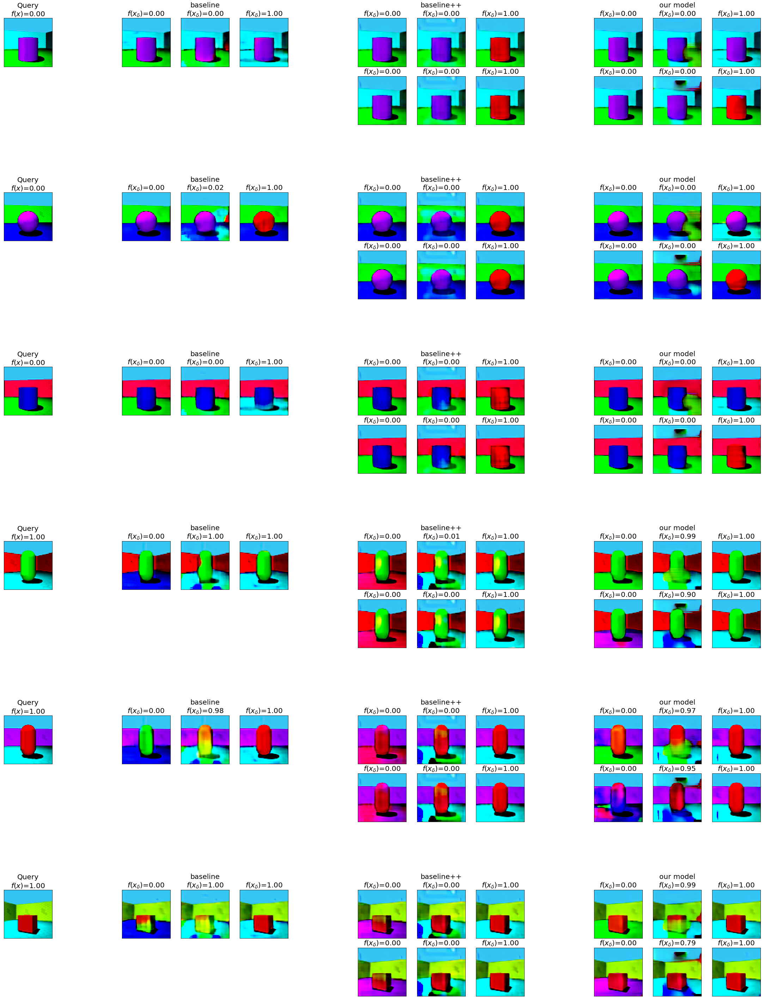

In [14]:
%%capture --no-display
# latest checkpoint
plot_qualitative_results({'baseline': baseline_results, 
                          'baseline++': baseline_plus_results, 
                          'our model': ours_results}, SHAPES_SAMPLE_INDICES_SUBSET)

# Main quantitative

In [15]:
print_metrics_table({'baseline': BASELINE_CONFIG,
                     'baseline++': BASELINE_PLUS_CONFIG,
                     'CSVAE': CSVAE_SHAPES_CONFIG,
                     'our model': OURS_CONFIG})

       method  influential_pearson_r  influential_pearson_p  \
0   our model                  0.822                  0.000   
1    baseline                  0.811                  0.000   
2       CSVAE                 -0.066                  0.001   
3  baseline++                  0.868                  0.000   

   influential_spearman_r  influential_spearman_p  influential_KL  \
0                   0.803                     0.0           2.915   
1                   0.823                     0.0           2.591   
2                  -0.557                     0.0          18.411   
3                   0.676                     0.0           4.322   

   realistic_accuracy  realistic_precision  realistic_recall  \
0              99.180               99.193            99.153   
1              99.360               98.747           100.000   
2              94.531               95.522            94.118   
3             100.000              100.000           100.000   

   distinct_accur

,method,influential_pearson_r,influential_pearson_p,influential_spearman_r,influential_spearman_p,influential_KL,realistic_accuracy,realistic_precision,realistic_recall,distinct_accuracy,...,substitutability_accuracy,substitutability_precision,substitutability_recall,generalization_accuracy,generalization_precision,generalization_recall,stability_l2_fake_t_img,stability_l2_fake_s_recon_img,stability_l2_recon_p,stability_l2_fake_p
0,our model,0.822,0.000,0.803,0.0,2.915,99.180,99.193,99.153,99.980,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,baseline,0.811,0.000,0.823,0.0,2.591,99.360,98.747,100.000,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,CSVAE,-0.066,0.001,-0.557,0.0,18.411,94.531,95.522,94.118,39.844,...,49.609,0.0,0.0,NaN,NaN,NaN,0.642,0.668,0.034,0.003
3,baseline++,0.868,0.000,0.676,0.0,4.322,100.000,100.000,100.000,44.940,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


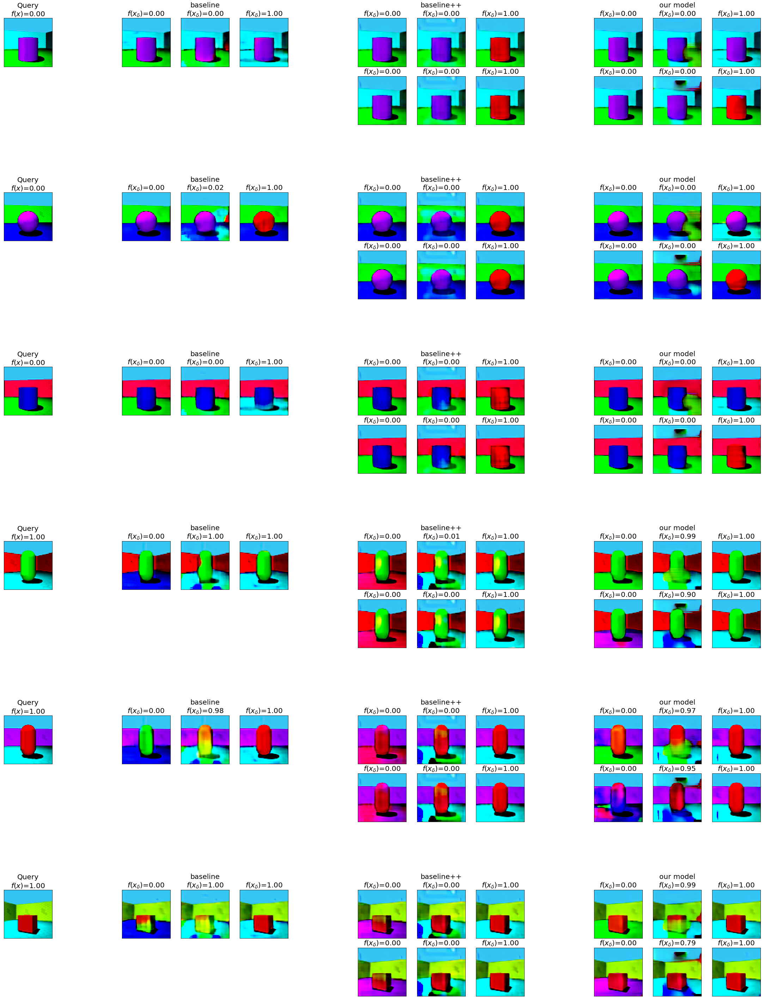

In [16]:
%%capture --no-display
plot_qualitative_results({'baseline': baseline_results, 
                          'baseline++': baseline_plus_results, 
                          'our model': ours_results}, SHAPES_SAMPLE_INDICES_SUBSET)

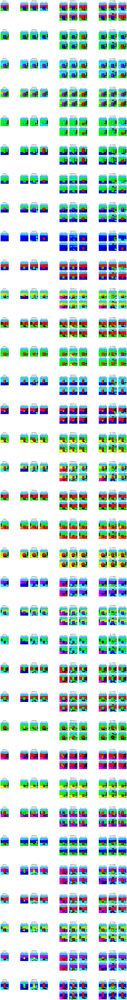

In [17]:
%%capture --no-display
plot_qualitative_results({'baseline': baseline_results, 
                          'baseline++': baseline_plus_results, 
                          'our model': ours_results}, SHAPES_SAMPLE_INDICES)

# Visualizing Experiments Results

experiment with your config file of interest. To avoid stdout clutter, use %%capture --no-display at the begining of each cell.

## Shapes
Label: redcyan - True if shape is red or floor is cyan

INFO:tensorflow:Restoring parameters from ./output/discoverer/redcyan_experiments/shapes_redcyan_Explainer/ckpt_dir/model154500.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcyan/cp1_epoch4.ckpt


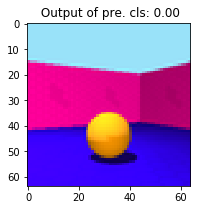

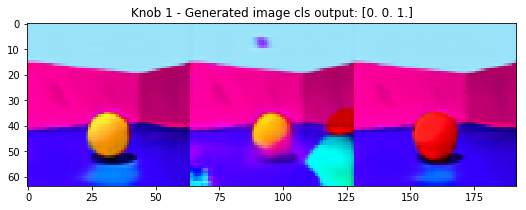

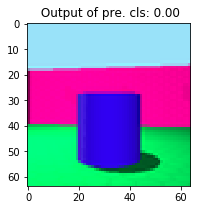

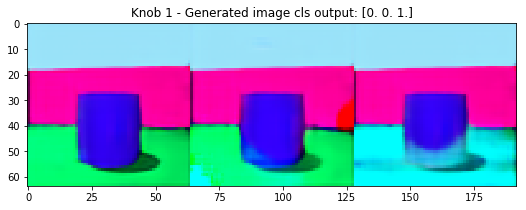

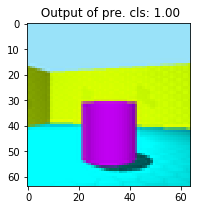

...

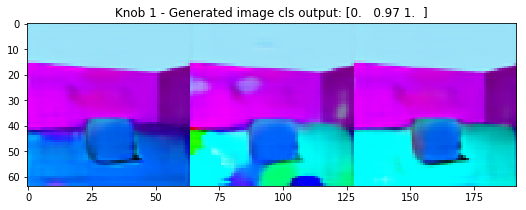

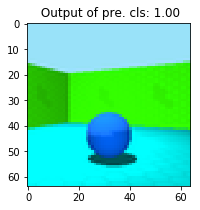

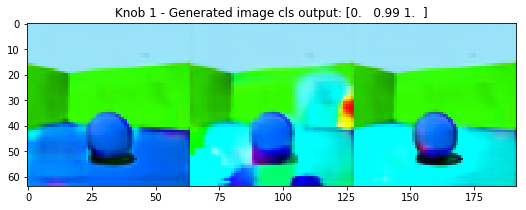

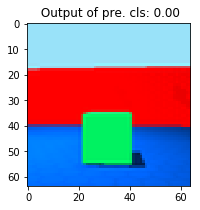

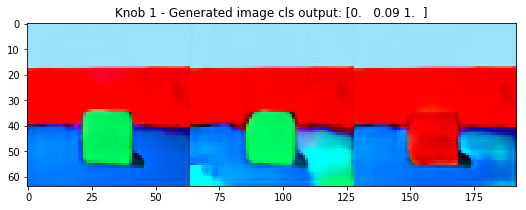

In [18]:
%%capture --no-display
# Baseline with 1 knob
view_images('./configs/redcyan_experiments/shapes_redcyan_Explainer.yaml', 35,
            img_indices=SHAPES_SAMPLE_INDICES, img_label_dict=SHAPES_IMG_LBL_DICT)

INFO:tensorflow:Restoring parameters from ./output/discoverer/redcyan_experiments/shapes_redcyan_Explainer_2_dim/ckpt_dir/model151500.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcyan/cp1_epoch4.ckpt


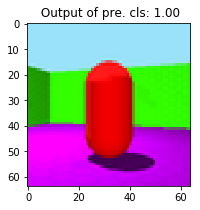

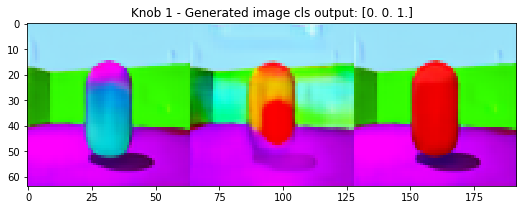

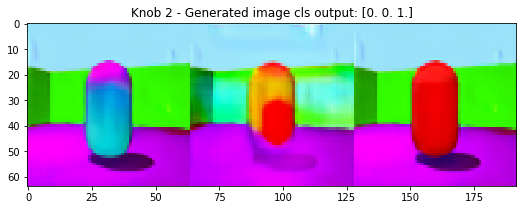

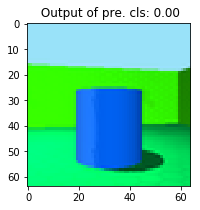

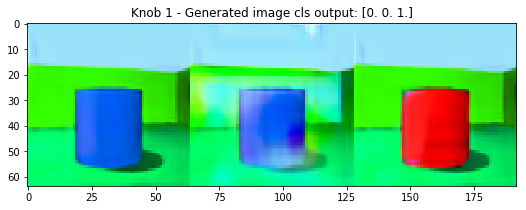

...

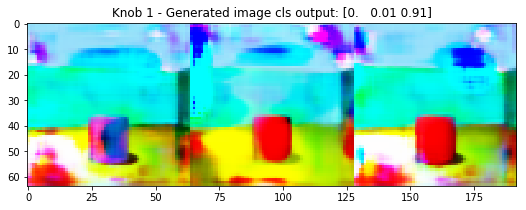

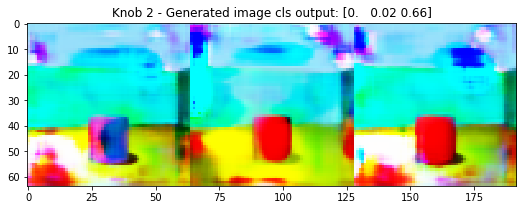

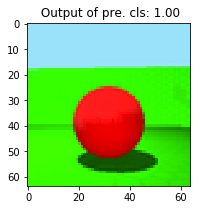

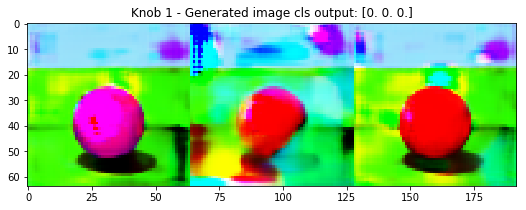

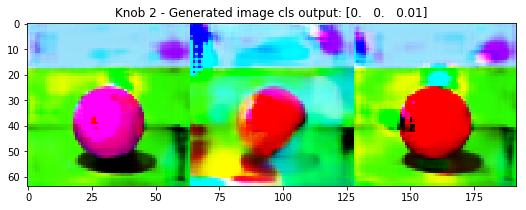

In [19]:
%%capture --no-display
# Baseline with 2 knob, no disentangler (regularizer)
view_images('./configs/redcyan_experiments/shapes_redcyan_Explainer_2_dim.yaml', 35, 
            img_indices=SHAPES_SAMPLE_INDICES, img_label_dict=SHAPES_IMG_LBL_DICT)

INFO:tensorflow:Restoring parameters from ./output/discoverer/redcyan_experiments/shapes_redcyan_Discoverer_2_dim_r10/ckpt_dir/model219000.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcyan/cp1_epoch4.ckpt


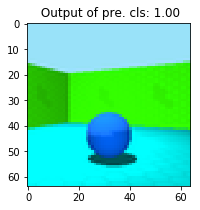

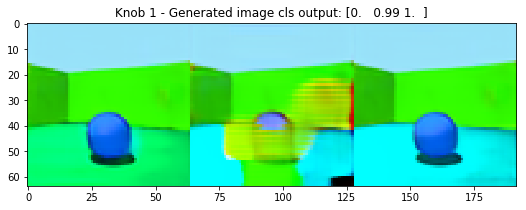

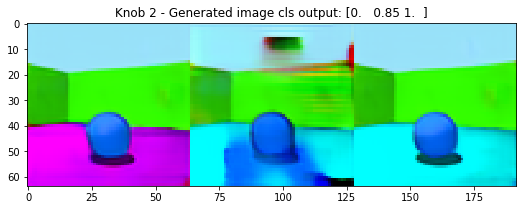

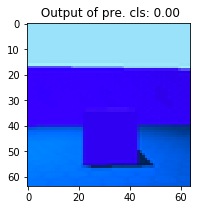

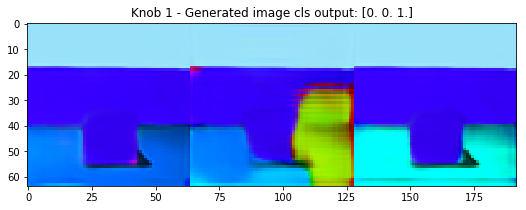

...

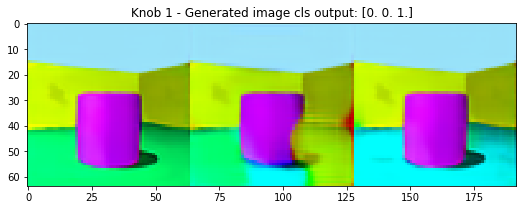

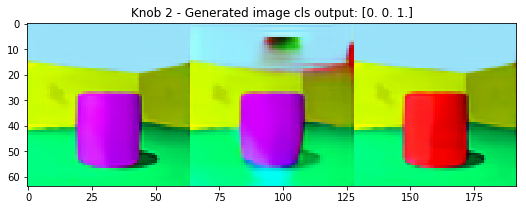

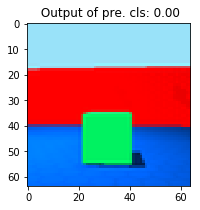

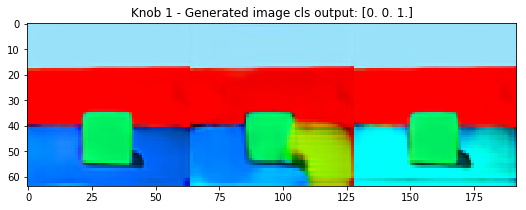

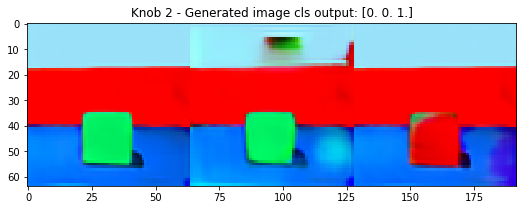

In [20]:
%%capture --no-display
# Our method with disentangler, with 2 knob, 
view_images('./configs/redcyan_experiments/shapes_redcyan_Discoverer_2_dim_r10.yaml', 35, 
            img_indices=SHAPES_SAMPLE_INDICES, img_label_dict=SHAPES_IMG_LBL_DICT)

# Legacy

with random samples

INFO:tensorflow:Restoring parameters from ./output/discoverer/redcyan_experiments/shapes_redcyan_Explainer/ckpt_dir/model154500.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcyan/cp1_epoch4.ckpt


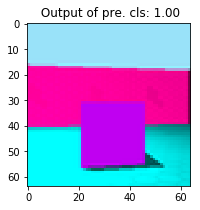

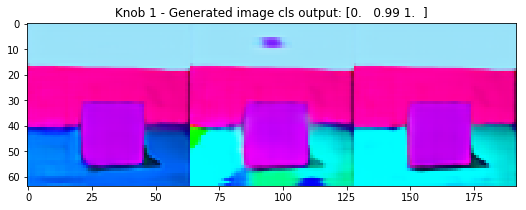

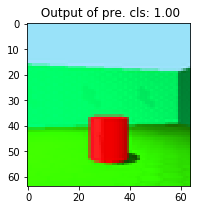

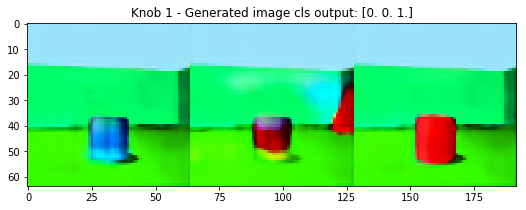

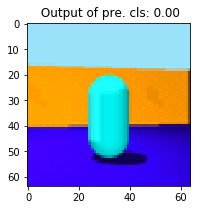

...

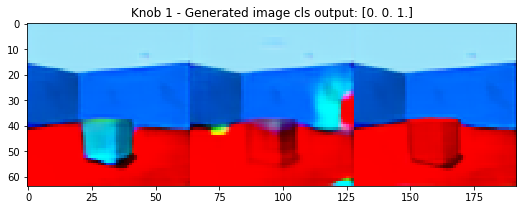

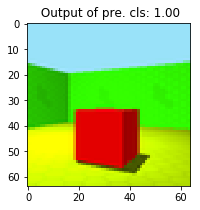

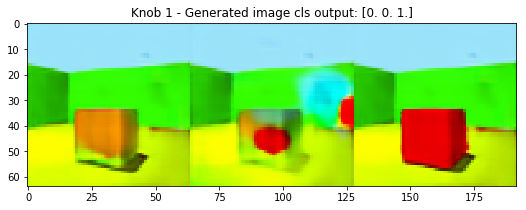

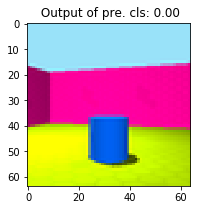

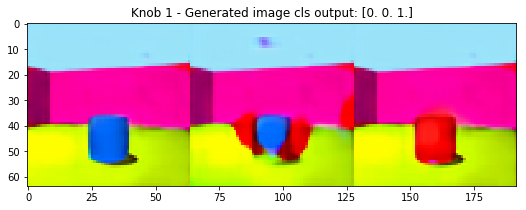

In [21]:
%%capture --no-display
# Baseline with 1 knob
view_images('./configs/redcyan_experiments/shapes_redcyan_Explainer.yaml', 8)

INFO:tensorflow:Restoring parameters from ./output/discoverer/redcyan_experiments/shapes_redcyan_Explainer_2_dim/ckpt_dir/model151500.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcyan/cp1_epoch4.ckpt


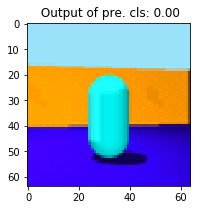

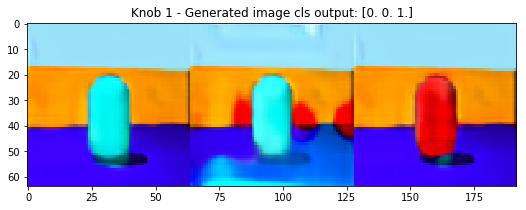

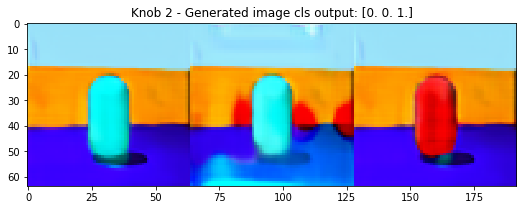

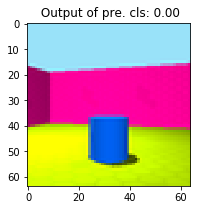

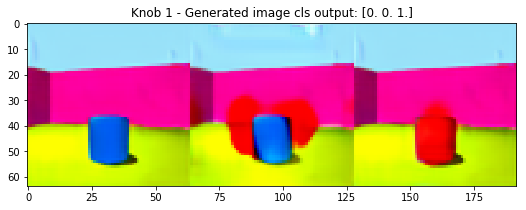

...

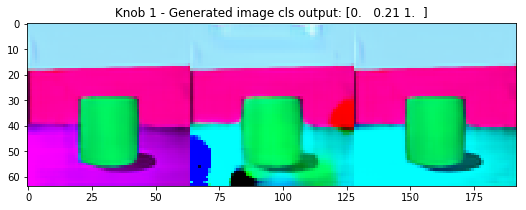

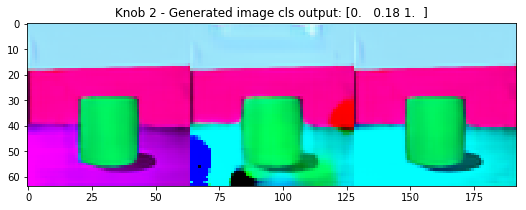

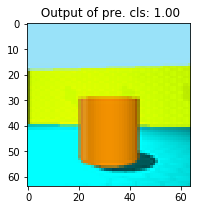

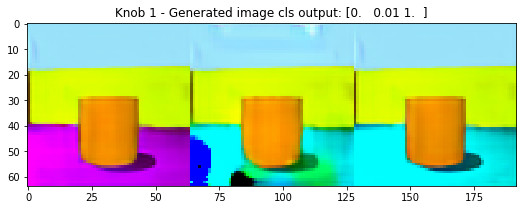

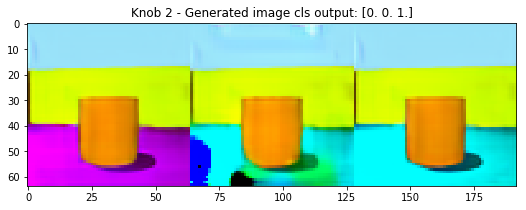

In [22]:
%%capture --no-display
# Baseline with 2 knob, no disentangler (regularizer)
view_images('./configs/redcyan_experiments/shapes_redcyan_Explainer_2_dim.yaml', 8)

INFO:tensorflow:Restoring parameters from ./output/discoverer/redcyan_experiments/shapes_redcyan_Discoverer_2_dim_r10/ckpt_dir/model219000.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcyan/cp1_epoch4.ckpt


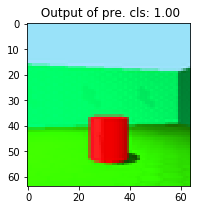

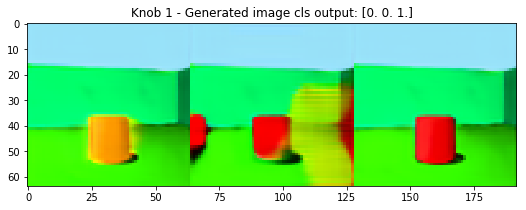

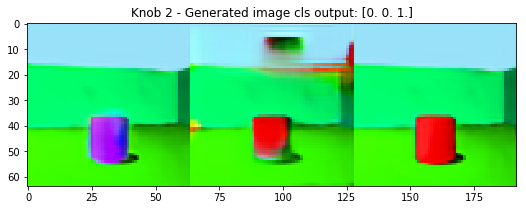

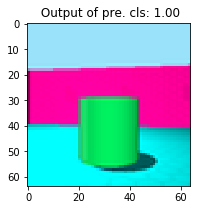

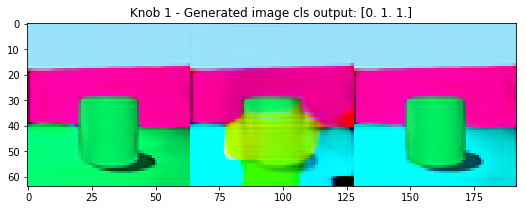

...

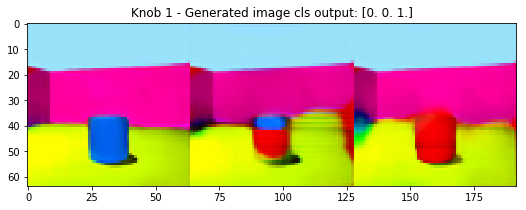

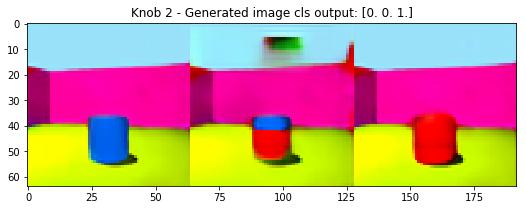

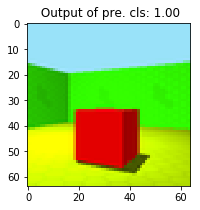

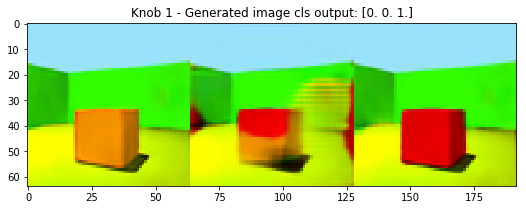

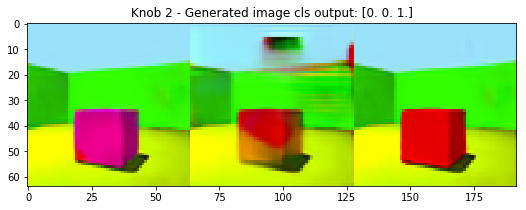

In [23]:
%%capture --no-display
# Our method with disentangler, with 2 knob, 
view_images('./configs/redcyan_experiments/shapes_redcyan_Discoverer_2_dim_r10.yaml', 8)

## red color
On classifier trained for 5 epochs
With L1

INFO:tensorflow:Restoring parameters from ./output/discoverer/redshapes_experiments/shapes_redcolor_Discoverer_2_dim_r_10_l1/ckpt_dir/model181000.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcolor/cp1_epoch4.ckpt


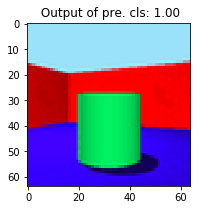

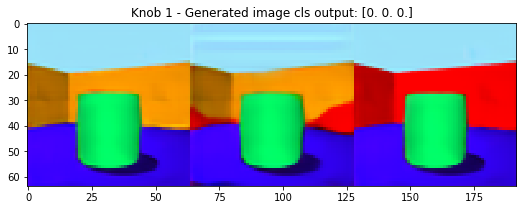

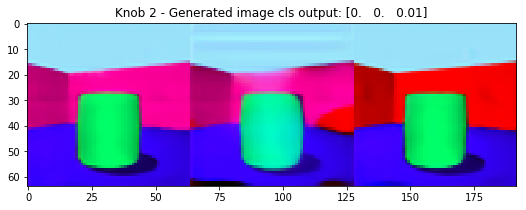

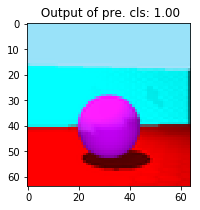

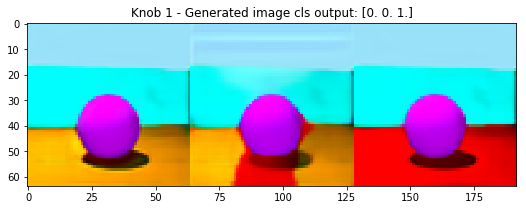

...

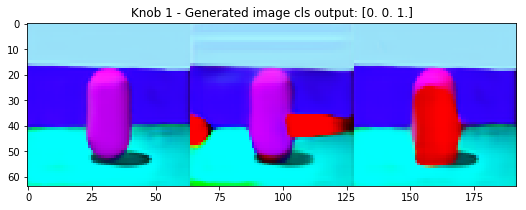

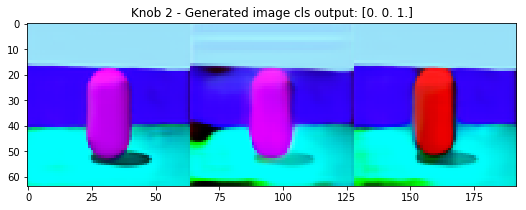

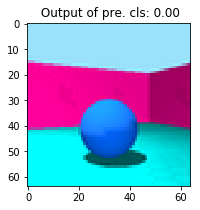

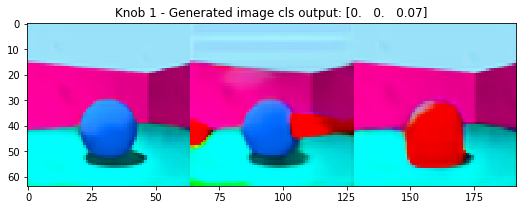

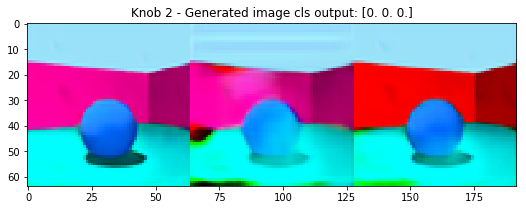

In [24]:
%%capture --no-display
view_images('./configs/redshapes_experiments/shapes_redcolor_Discoverer_2_dim_r_10_l1.yaml', 8)

INFO:tensorflow:Restoring parameters from ./output/discoverer/redshapes_experiments/shapes_redcolor_Discoverer_2_dim_r_50_l1/ckpt_dir/model12000.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcolor/cp1_epoch4.ckpt


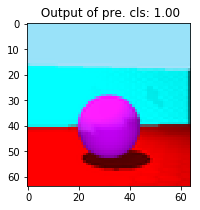

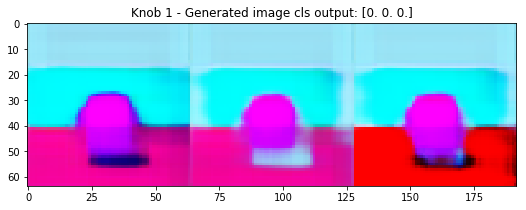

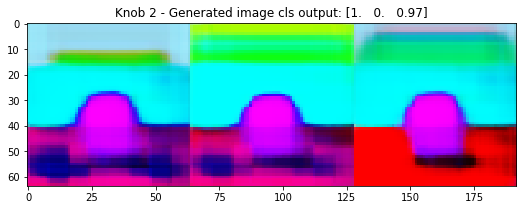

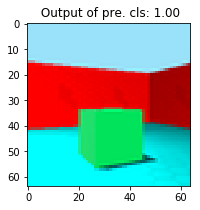

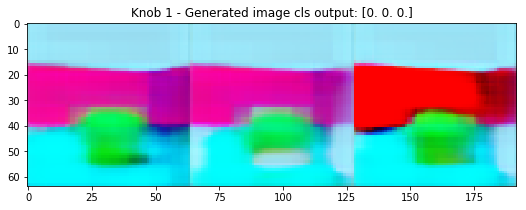

...

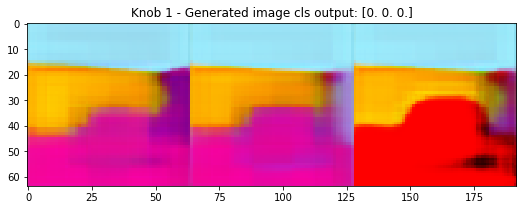

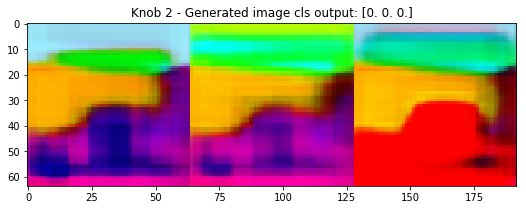

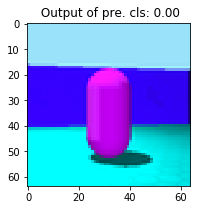

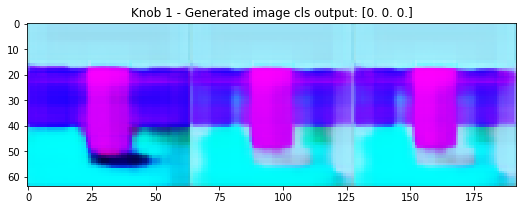

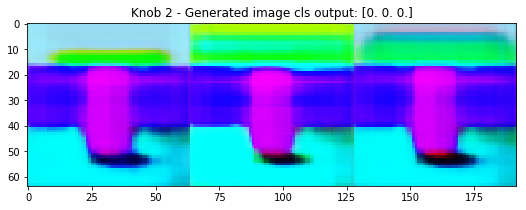

In [25]:
%%capture --no-display
view_images('./configs/redshapes_experiments/shapes_redcolor_Discoverer_2_dim_r_50_l1.yaml', 8)

INFO:tensorflow:Restoring parameters from ./output/discoverer/redshapes_experiments/shapes_redcolor_Discoverer_10_dim_r_10_l1/ckpt_dir/model28000.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcolor/cp1_epoch4.ckpt


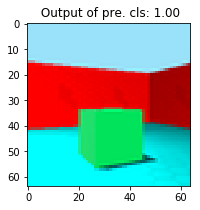

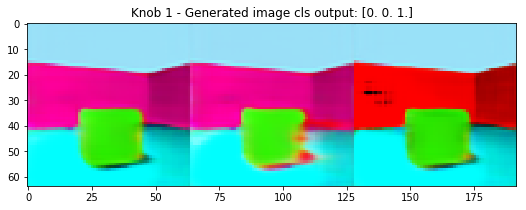

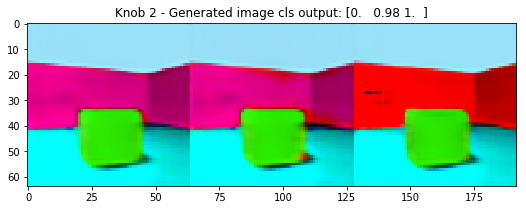

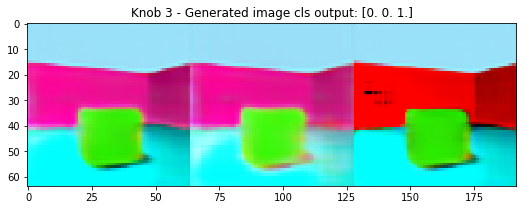

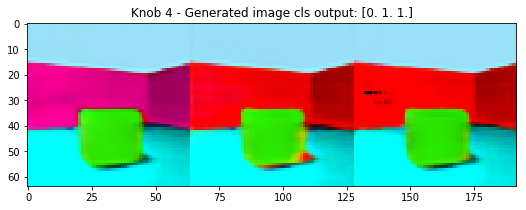

...

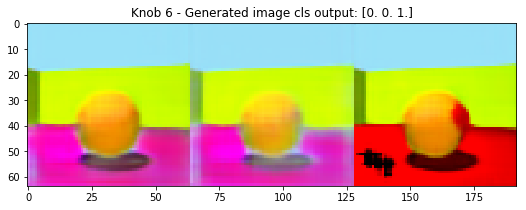

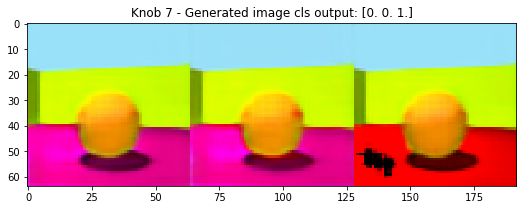

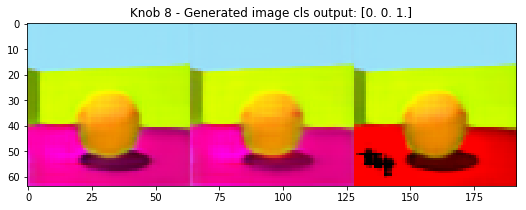

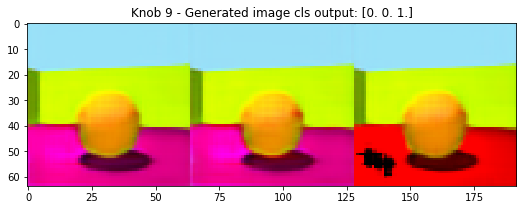

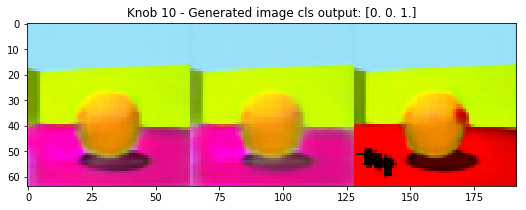

In [26]:
%%capture --no-display
view_images('./configs/redshapes_experiments/shapes_redcolor_Discoverer_10_dim_r_10_l1.yaml', 8)

## red color
On classifier trained for 5 epochs
Without L1

INFO:tensorflow:Restoring parameters from ./output/discoverer/redshapes_experiments/shapes_redcolor_Explainer/ckpt_dir/model524000.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcolor/cp1_epoch4.ckpt


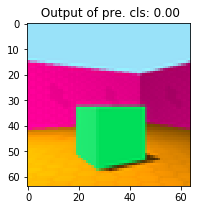

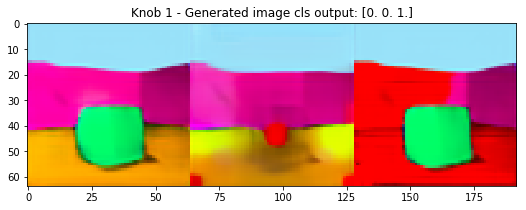

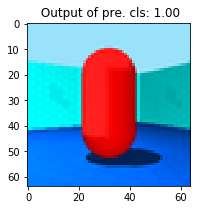

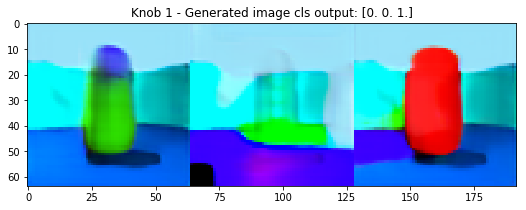

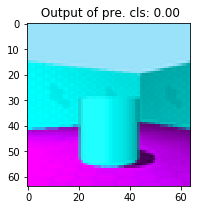

...

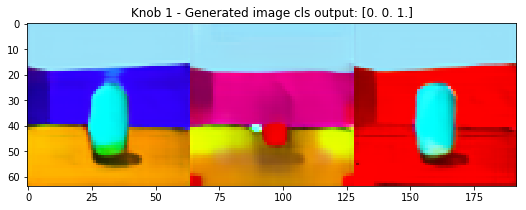

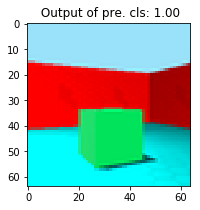

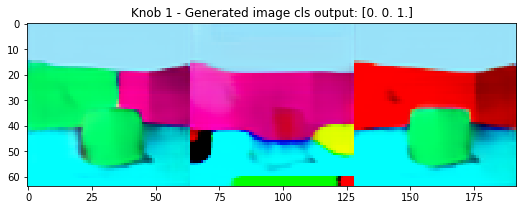

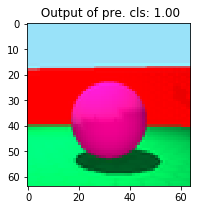

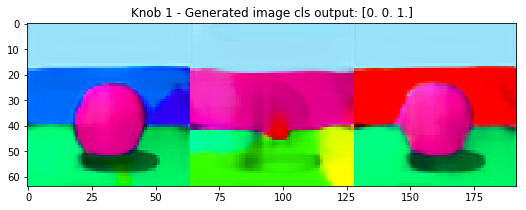

In [27]:
%%capture --no-display
view_images('./configs/redshapes_experiments/shapes_redcolor_Explainer.yaml', 8)

INFO:tensorflow:Restoring parameters from ./output/discoverer/redshapes_experiments/shapes_redcolor_Discoverer_2_dim_r_10/ckpt_dir/model294500.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcolor/cp1_epoch4.ckpt


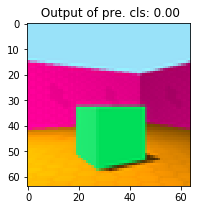

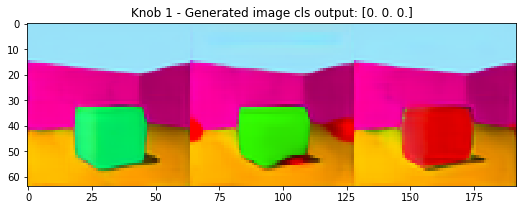

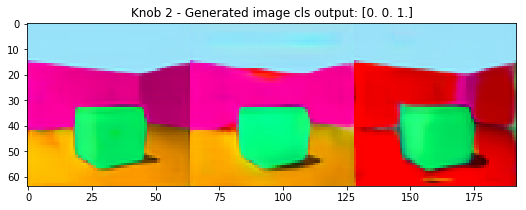

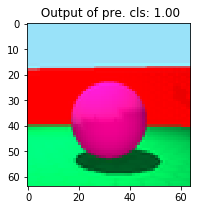

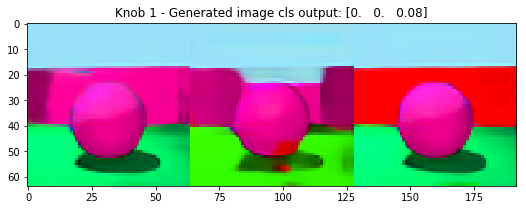

...

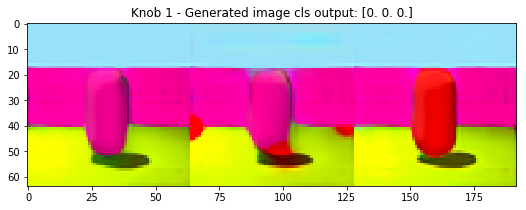

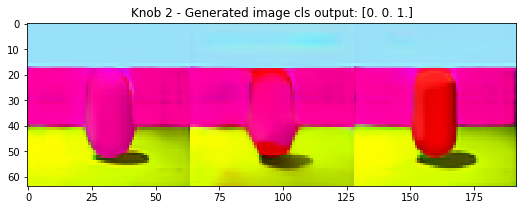

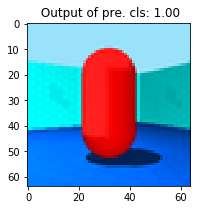

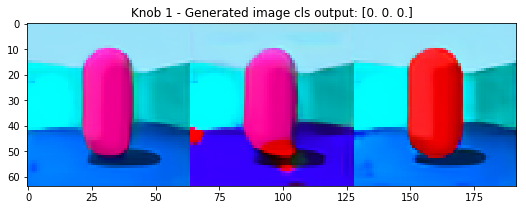

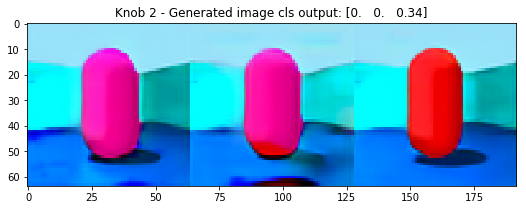

In [28]:
%%capture --no-display
view_images('./configs/redshapes_experiments/shapes_redcolor_Discoverer_2_dim_r_10.yaml', 8)

INFO:tensorflow:Restoring parameters from ./output/discoverer/redshapes_experiments/shapes_redcolor_Discoverer_2_dim_r_50/ckpt_dir/model296000.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcolor/cp1_epoch4.ckpt


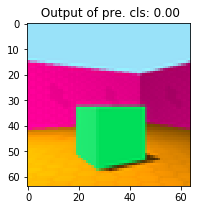

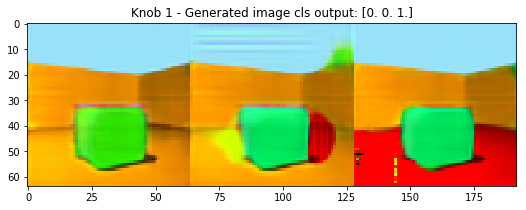

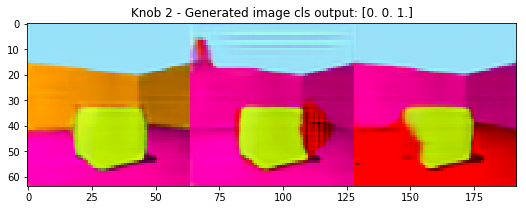

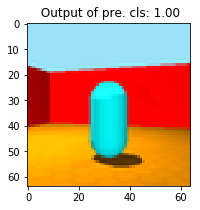

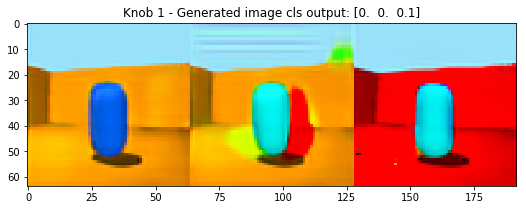

...

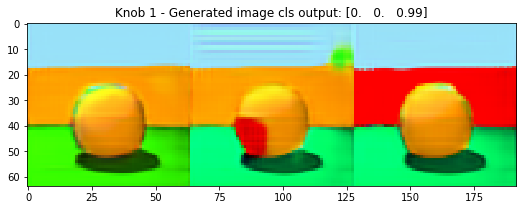

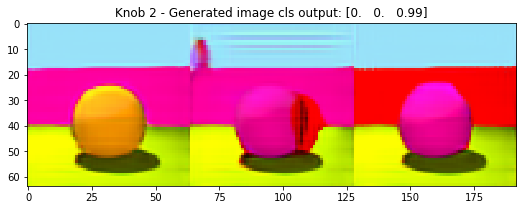

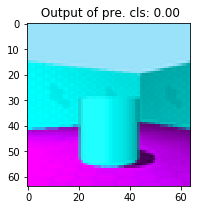

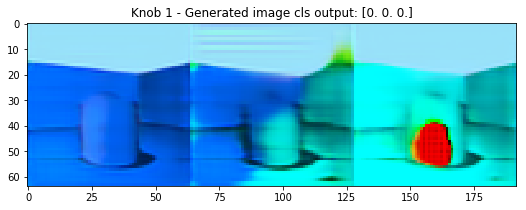

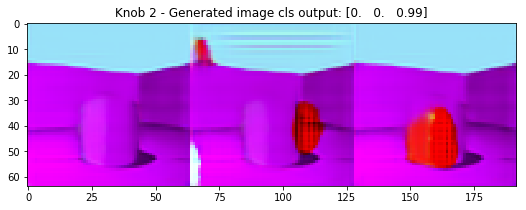

In [29]:
%%capture --no-display
view_images('./configs/redshapes_experiments/shapes_redcolor_Discoverer_2_dim_r_50.yaml', 8)

## Shapes (classifier only trained for one epoch on a dataset of size ~ 10000)
Without L1

INFO:tensorflow:Restoring parameters from ./output/explainer/shapes_red/shapes_redcolor_Explainer_newarch/ckpt_dir/model93500.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcolor_1/cp1_epoch0.ckpt


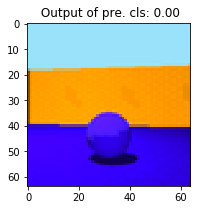

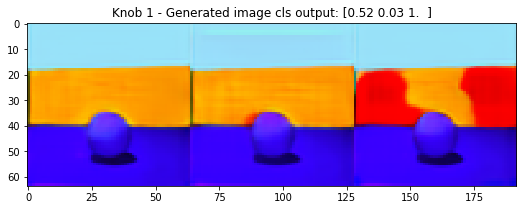

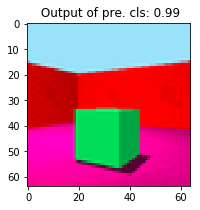

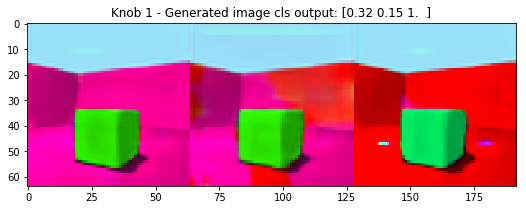

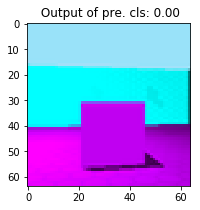

...

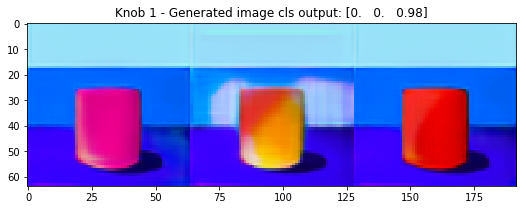

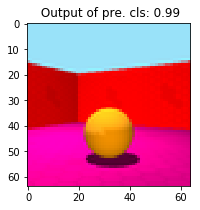

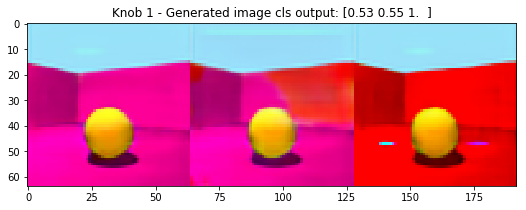

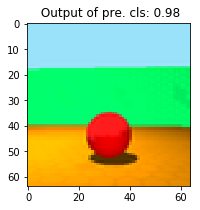

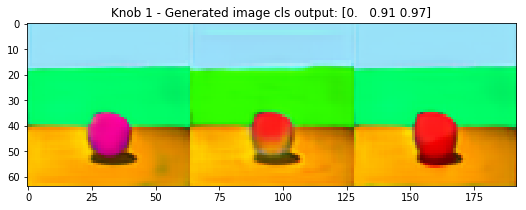

In [30]:
%%capture --no-display
# baseline
view_images('./configs/shapes_redcolor_Explainer_newarch.yaml', 8)

INFO:tensorflow:Restoring parameters from ./output/explainer/shapes_red/shapes-redcolor-Binary-Disentangled_2_newarch_r10/ckpt_dir/model93500.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcolor_1/cp1_epoch0.ckpt


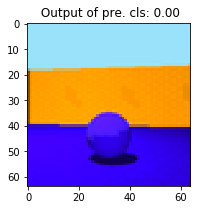

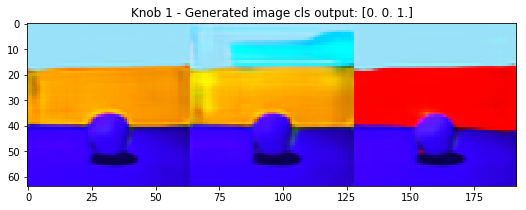

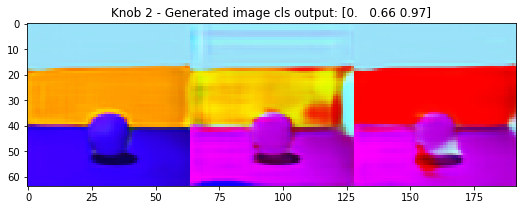

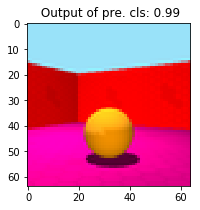

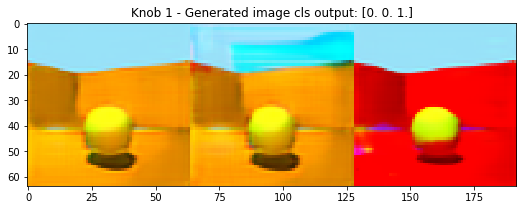

...

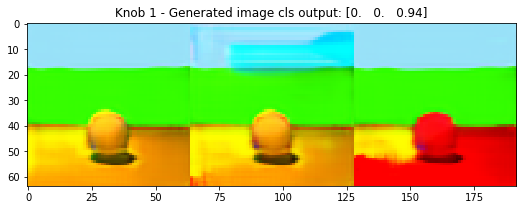

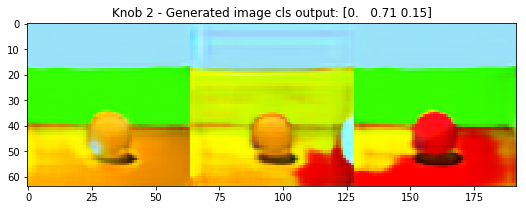

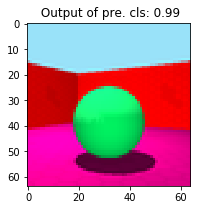

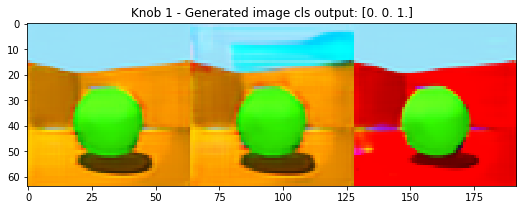

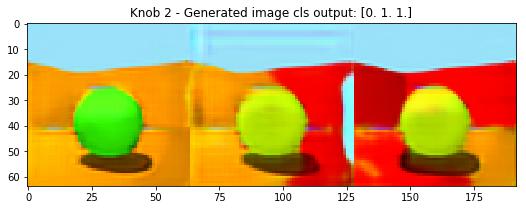

In [31]:
%%capture --no-display
# r 10
view_images('./configs/shapes_redcolor_Explainer_disentangled_2_newarch_r10.yaml', 8)

INFO:tensorflow:Restoring parameters from ./output/explainer/shapes_red/shapes-redcolor-Binary-Disentangled_2_newarch_gr/ckpt_dir/model93500.ckpt
INFO:tensorflow:Restoring parameters from ./output/classifier/shapes-redcolor_1/cp1_epoch0.ckpt


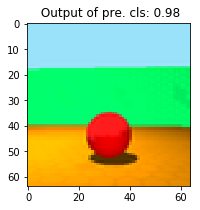

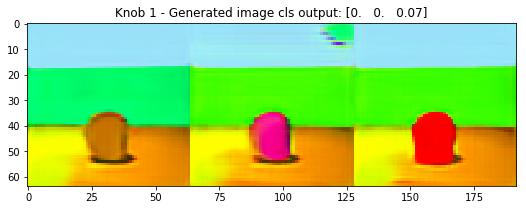

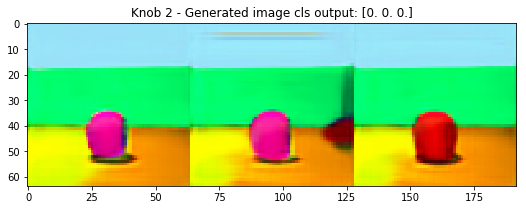

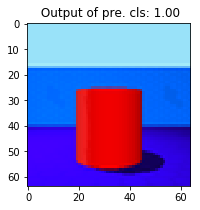

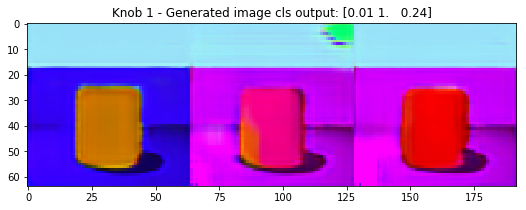

...

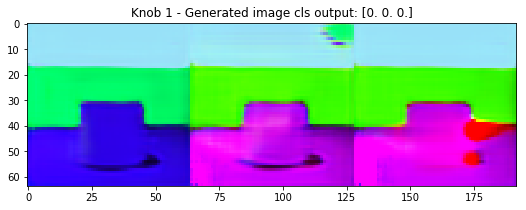

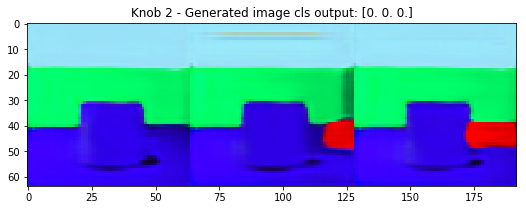

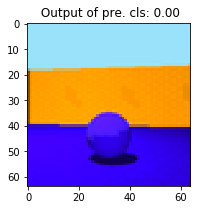

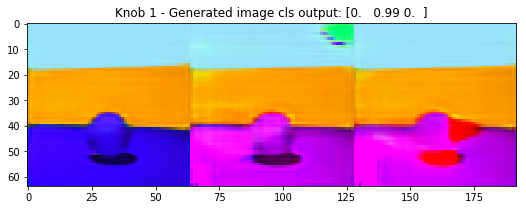

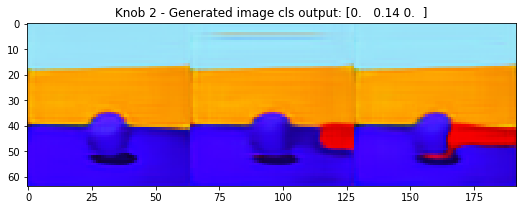

In [32]:
%%capture --no-display
# r 50
view_images('./configs/shapes_redcolor_Explainer_disentangled_2_newarch_gr.yaml', 8)